In [1]:
import torch

In [2]:
torch.cuda.get_device_name(0)

'NVIDIA GeForce GTX 1070'

In [1]:
%pip install git+https://github.com/facebookresearch/segment-anything.git

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-9x9rf8c6
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-9x9rf8c6
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36586 sha256=bf396a814c8784709bd017ce218e18a3367d5e35f03daecfa157d0b99689ac8d
  Stored in directory: /tmp/pip-ephem-wheel-cache-fun_vvug/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
Note: you may need to restart the kernel to use updated packages.


In [1]:
%ls '/var/seda-test-model-HR/weights/'

cascade_s2anet_2s_r50_fpn_3x_hrsc2021_dota_v10_epoch_36.pth*
sam_vit_h_4b8939.pth*


In [1]:
sam_checkpoint_file = '/var/seda-test-model-HR/weights/sam_vit_h_4b8939.pth'
from segment_anything import SamPredictor, sam_model_registry, SamAutomaticMaskGenerator
from matplotlib import pyplot as plt
device = "cuda:0"
sam = sam_model_registry["vit_h"](checkpoint=sam_checkpoint_file)
sam.to(device=device)
predictor = SamPredictor(sam)

In [2]:
from ultralytics import FastSAM
from ultralytics.models.fastsam import FastSAMPrompt

In [3]:
model = FastSAM('FastSAM-s.pt')  # or FastSAM-x.pt


image 1/1 /usr/src/ultralytics/notebooks/images/dog.jpg: 1024x1024 18 objects, 28.0ms
Speed: 43.8ms preprocess, 28.0ms inference, 7.3ms postprocess per image at shape (1, 3, 1024, 1024)
Saved to /usr/src/ultralytics/notebooks/dog.jpg


CPU times: user 4.83 s, sys: 773 ms, total: 5.6 s
Wall time: 5.58 s


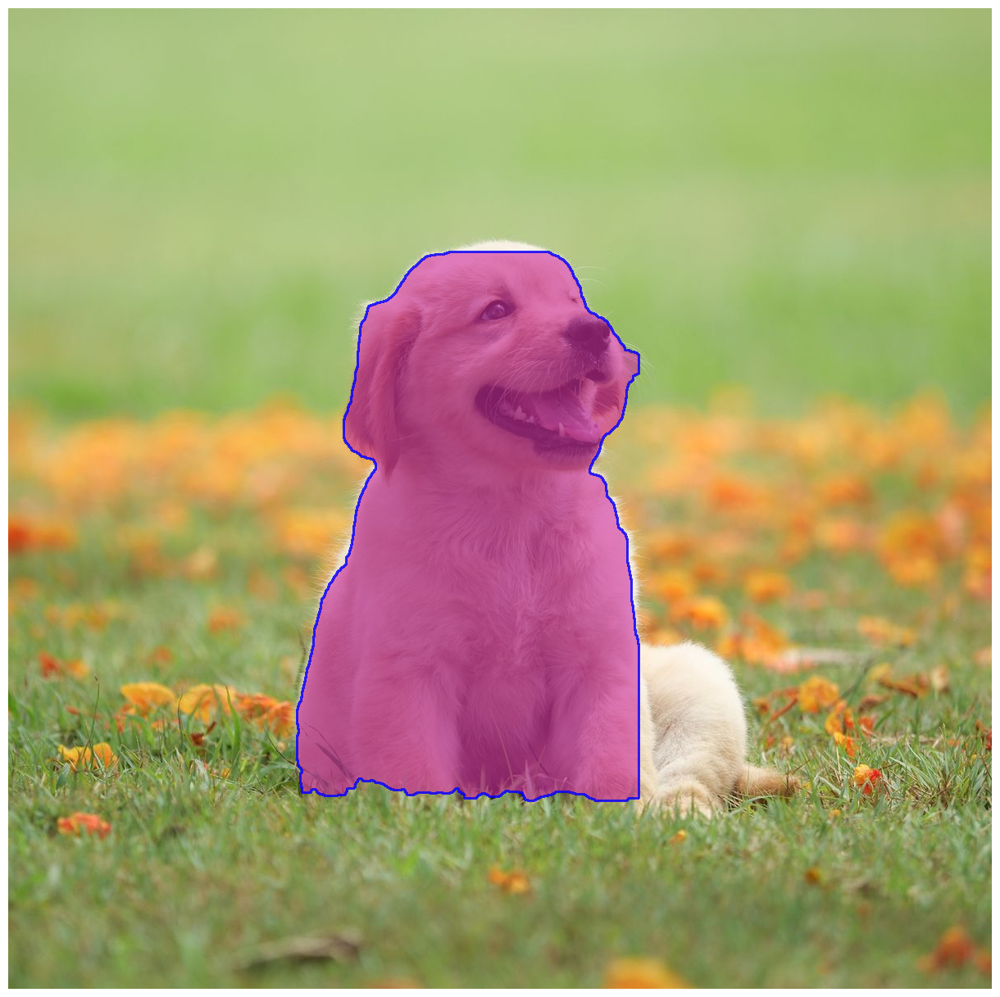

In [8]:
%%time
# Define an inference source
source = 'images/dog.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Text prompt
ann = prompt_process.text_prompt(text='a photo of a dog')

prompt_process.plot(annotations=ann, output='./')


image 1/1 /usr/src/ultralytics/notebooks/images/dogs.jpg: 768x1024 78 objects, 62.3ms
Speed: 49.4ms preprocess, 62.3ms inference, 17.3ms postprocess per image at shape (1, 3, 768, 1024)
Saved to /usr/src/ultralytics/notebooks/dogs.jpg


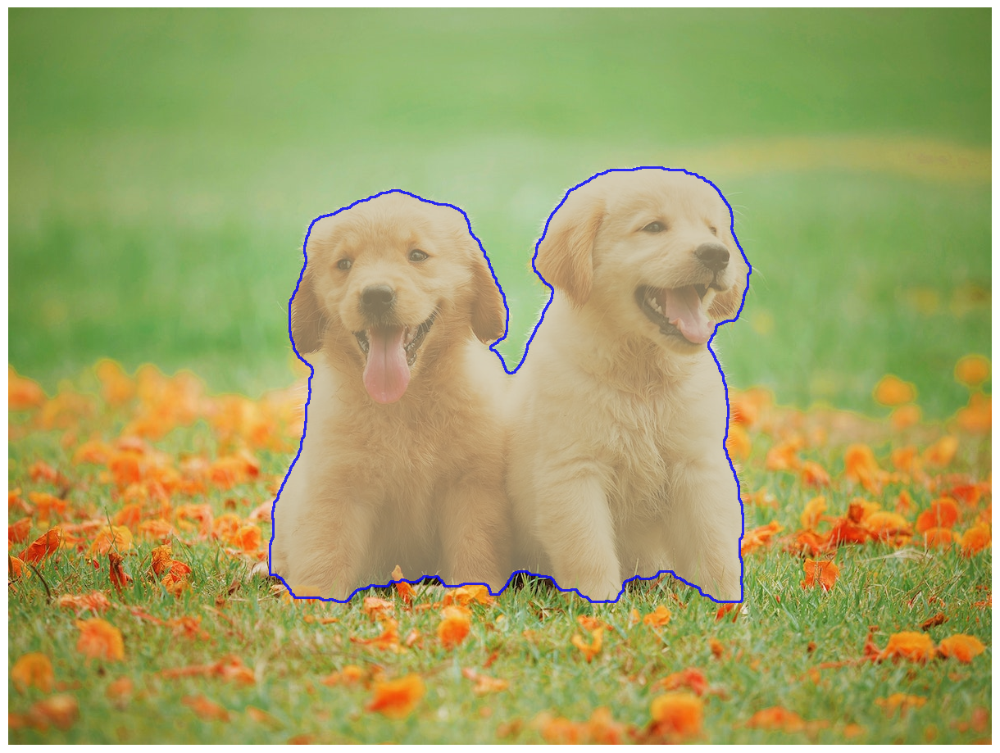

In [9]:
# Define an inference source
source = 'images/dogs.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='a photo of a dogs')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')

In [8]:
%%time
source = 'images/dogs.jpg'
im = plt.imread(source)

mask_generator = SamAutomaticMaskGenerator(sam)
masks = mask_generator.generate(im)

CPU times: user 7.6 s, sys: 2.18 s, total: 9.78 s
Wall time: 10.8 s


In [2]:
import numpy as np
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

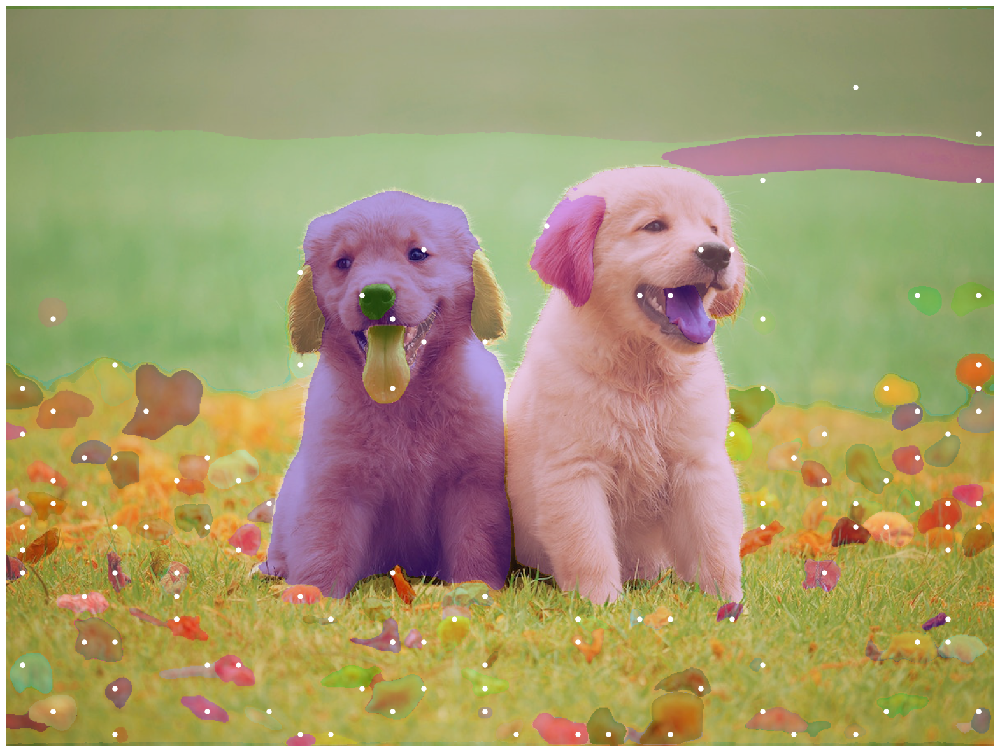

In [13]:
plt.figure(figsize=(20,20))
plt.imshow(im)
show_anns(masks)
for segmentation in masks:
    p = segmentation['point_coords'][0]
    plt.plot(p[0], p[1], "ow", markersize=5)
plt.axis('off')
plt.show() 


image 1/1 /usr/src/ultralytics/notebooks/images/dogs.jpg: 768x1024 78 objects, 18.9ms
Speed: 5.6ms preprocess, 18.9ms inference, 16.4ms postprocess per image at shape (1, 3, 768, 1024)
Saved to /usr/src/ultralytics/notebooks/dogs.jpg


CPU times: user 5.96 s, sys: 628 ms, total: 6.59 s
Wall time: 6.59 s


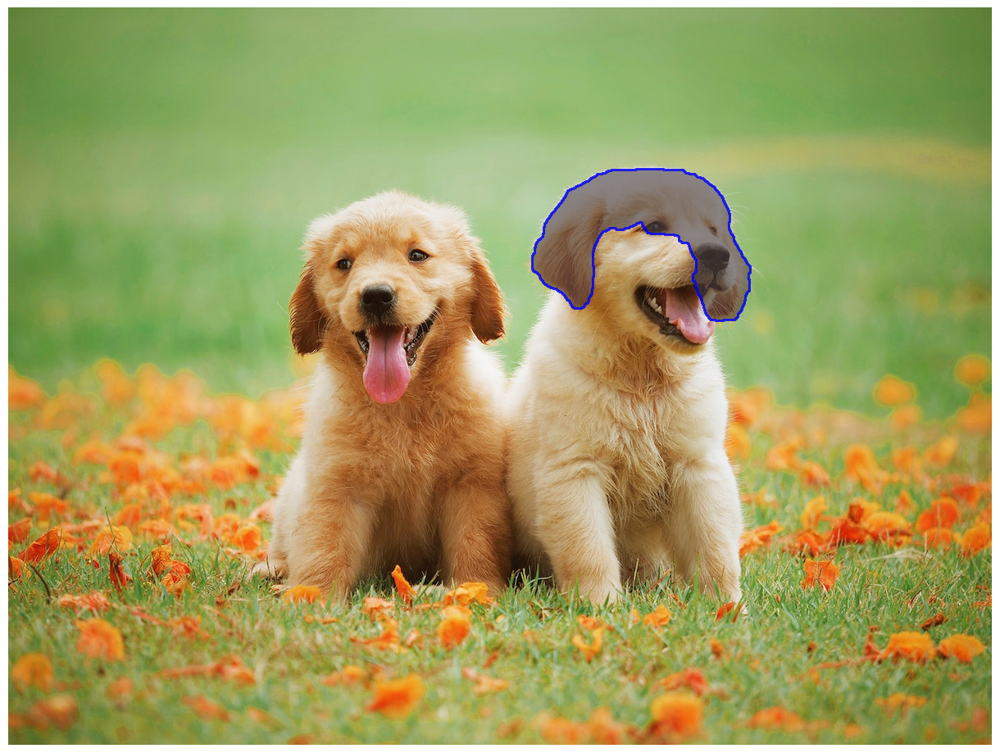

In [10]:
%%time
# Define an inference source
source = 'images/dogs.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='a photo of a dog')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')


image 1/1 /usr/src/ultralytics/notebooks/images/3dogs.jpg: 704x1024 38 objects, 70.9ms
Speed: 5.9ms preprocess, 70.9ms inference, 11.4ms postprocess per image at shape (1, 3, 704, 1024)
Saved to /usr/src/ultralytics/notebooks/3dogs.jpg


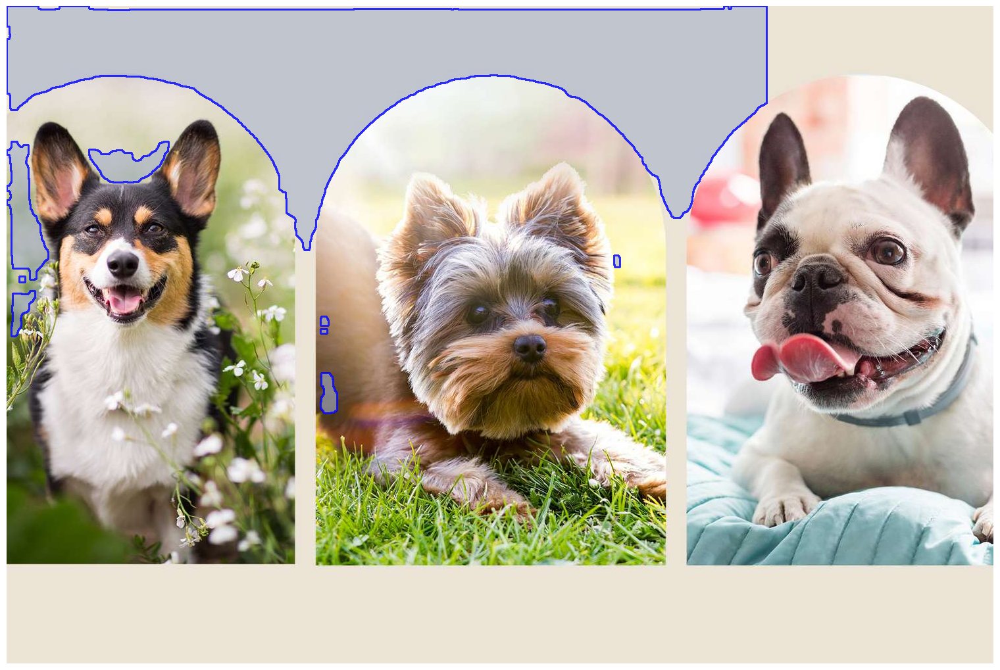

In [11]:
# Define an inference source
source = 'images/3dogs.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='a photo of 3 dogs')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')


image 1/1 /usr/src/ultralytics/notebooks/images/5dogs.jpg: 640x1024 21 objects, 64.1ms
Speed: 42.5ms preprocess, 64.1ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 1024)
Saved to /usr/src/ultralytics/notebooks/5dogs.jpg


CPU times: user 3.86 s, sys: 200 ms, total: 4.06 s
Wall time: 4.04 s


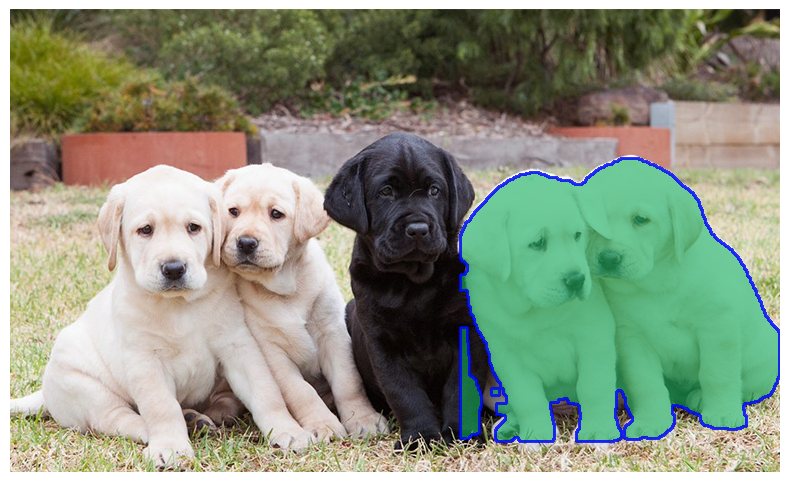

In [5]:
%%time
# Define an inference source
source = 'images/5dogs.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='a photo of five dogs')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')

In [14]:
%%time
source = 'images/5dogs.jpg'
im = plt.imread(source)

mask_generator = SamAutomaticMaskGenerator(sam)
masks = mask_generator.generate(im)

CPU times: user 5.16 s, sys: 1.96 s, total: 7.11 s
Wall time: 7.11 s


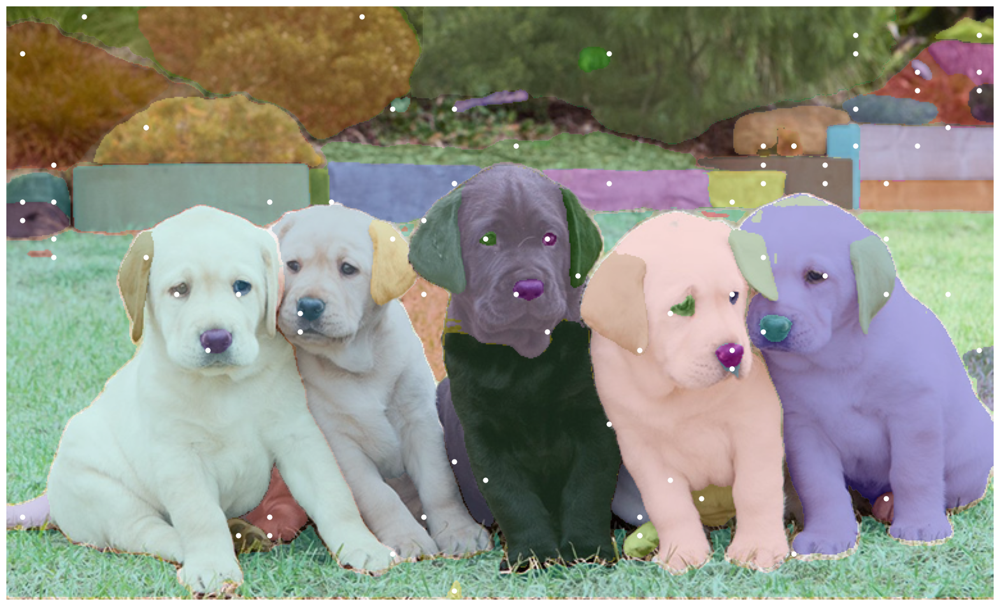

In [15]:
plt.figure(figsize=(20,20))
plt.imshow(im)
show_anns(masks)
for segmentation in masks:
    p = segmentation['point_coords'][0]
    plt.plot(p[0], p[1], "ow", markersize=5)
plt.axis('off')
plt.show() 


image 1/1 /usr/src/ultralytics/notebooks/images/5dogs.jpg: 640x1024 21 objects, 18.5ms
Speed: 37.6ms preprocess, 18.5ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 1024)
Saved to /usr/src/ultralytics/notebooks/5dogs.jpg


CPU times: user 3.77 s, sys: 200 ms, total: 3.97 s
Wall time: 3.96 s


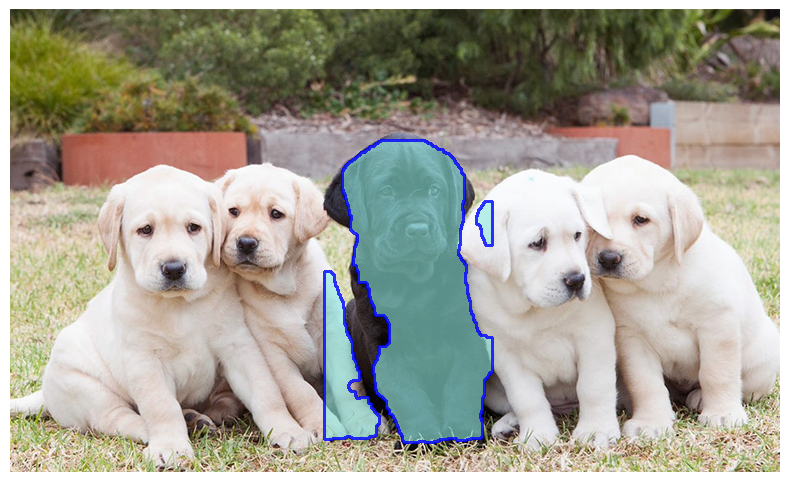

In [6]:
%%time
# Define an inference source
source = 'images/5dogs.jpg'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='the black dog')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')


image 1/1 /usr/src/ultralytics/notebooks/images/mosaic_RGB.tiff: 704x1024 127 objects, 68.0ms
Speed: 9.1ms preprocess, 68.0ms inference, 65.5ms postprocess per image at shape (1, 3, 704, 1024)
Saved to /usr/src/ultralytics/notebooks/mosaic_RGB.tiff


CPU times: user 17.7 s, sys: 4.25 s, total: 22 s
Wall time: 24.4 s


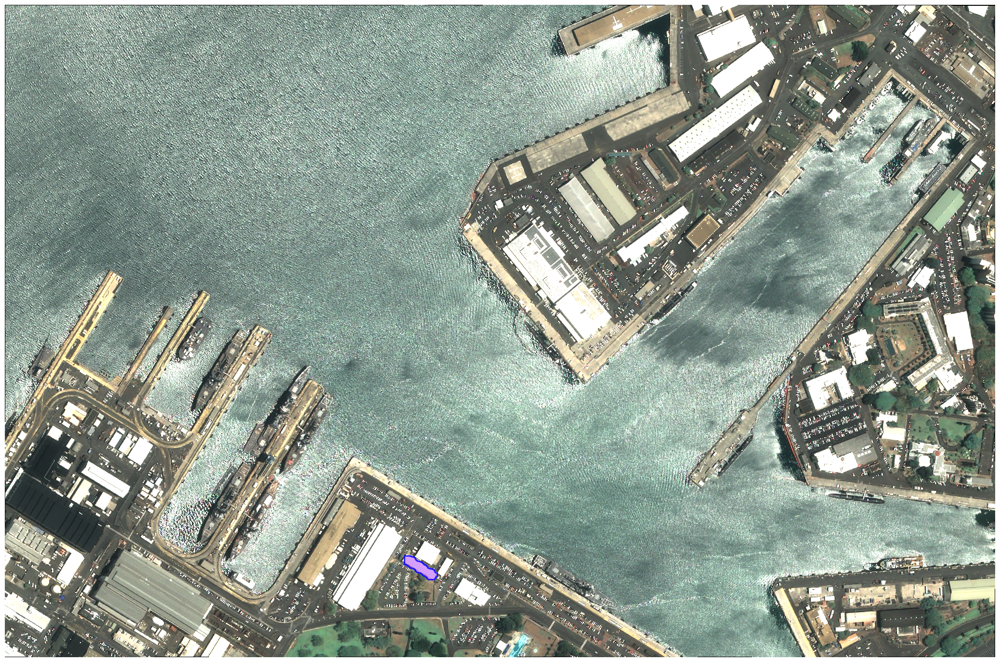

In [4]:
%%time
# Define an inference source
source = 'images/mosaic_RGB.tiff'

# Run inference on an image
everything_results = model(source, device=0, retina_masks=True, imgsz=1024, conf=0.4, iou=0.9)

# Prepare a Prompt Process object
prompt_process = FastSAMPrompt(source, everything_results, device=0)

# Everything prompt
#ann = prompt_process.everything_prompt()

# Bbox default shape [0,0,0,0] -> [x1,y1,x2,y2]
#ann = prompt_process.box_prompt(bbox=[200, 200, 300, 300])

# Text prompt
ann = prompt_process.text_prompt(text='a photo of ship')

# Point prompt
# points default [[0,0]] [[x1,y1],[x2,y2]]
# point_label default [0] [1,0] 0:background, 1:foreground
#ann = prompt_process.point_prompt(points=[[200, 200]], pointlabel=[1])
prompt_process.plot(annotations=ann, output='./')

In [ ]:
%%time
im_glint = 'images/mosaic_RGB.tiff'
im_path = im_glint
im = plt.imread(im_path)

mask_generator = SamAutomaticMaskGenerator(sam)
masks = mask_generator.generate(im)

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(im)
show_anns(masks)
for segmentation in masks:
    p = segmentation['point_coords'][0]
    plt.plot(p[0], p[1], "ow", markersize=5)
plt.axis('off')
plt.show() 